Category 'bricks' has 248 videos.
Category 'concrete' has 250 videos.
Category 'earth' has 243 videos.
Category 'tree' has 252 videos.


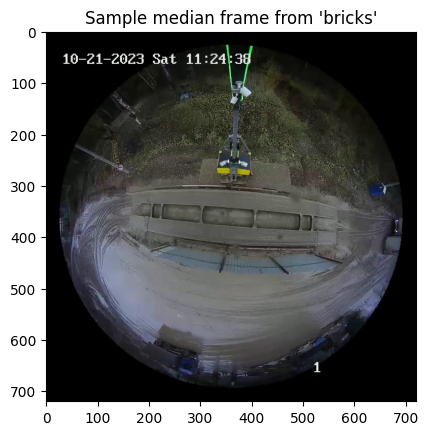

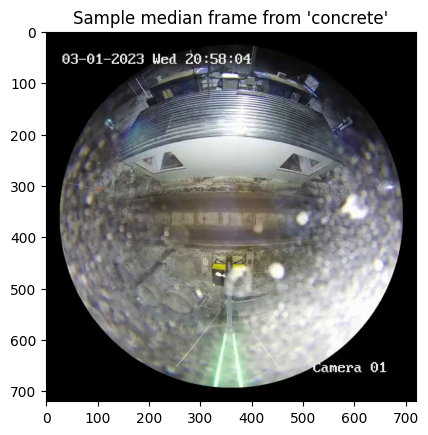

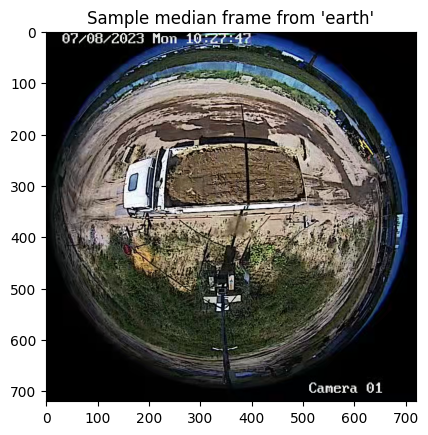

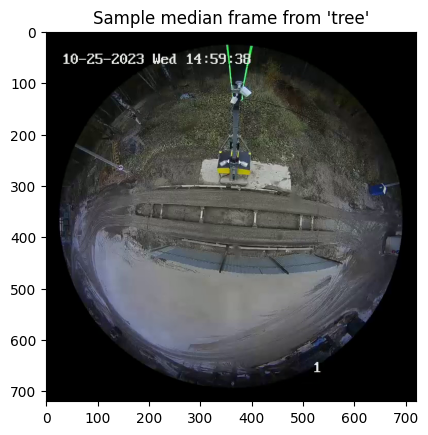

In [1]:
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np

# Define the dataset directory
dataset_dir = '/kaggle/input/mos-trash/train_dataset_train/train'

# List the contents of each folder
categories = ['bricks', 'concrete', 'earth', 'tree']
for category in categories:
    path = os.path.join(dataset_dir, category)
    videos = os.listdir(path)
    print(f"Category '{category}' has {len(videos)} videos.")

# Function to extract and display the median frame of the first video in each category
def display_median_frame(category):
    path = os.path.join(dataset_dir, category)
    video_file = os.listdir(path)[150]  # Take the 100th video
    video_path = os.path.join(path, video_file)

    cap = cv2.VideoCapture(video_path)

    if not cap.isOpened():
        print(f"Failed to open video: {video_path}")
        return

    # Get the total number of frames and calculate the median frame
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    median_frame_number = total_frames*4//5

    # Set the current frame position to the median frame
    cap.set(cv2.CAP_PROP_POS_FRAMES, median_frame_number)

    # Read the median frame
    ret, frame = cap.read()
    if ret:
        # Convert the frame from BGR to RGB
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        plt.imshow(frame_rgb)
        plt.title(f"Sample median frame from '{category}'")
        plt.show()
    else:
        print(f"Failed to read the median frame from: {video_path}")

    cap.release()

# Display median frames from each category
for category in categories:
    display_median_frame(category)


Statistics

In [ ]:
import pandas as pd
import seaborn as sns

# Function to get the duration of each video
def get_video_durations(path, videos):
    durations = []
    for video in videos:
        try:
            cap = cv2.VideoCapture(os.path.join(path, video))
            if cap.isOpened():
                fps = cap.get(cv2.CAP_PROP_FPS)
                total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
                duration = total_frames / fps
                durations.append(duration)
            cap.release()
        except Exception as e:
            print(f"Error processing {video}: {e}")
    return durations


# Collect durations for each category
duration_data = []
for category in categories:
    path = os.path.join(dataset_dir, category)
    videos = os.listdir(path)
    durations = get_video_durations(path, videos)
    for duration in durations:
        duration_data.append({'Category': category, 'Duration': duration})

# Convert to DataFrame for analysis
df_durations = pd.DataFrame(duration_data)

# Display descriptive statistics
print("Descriptive Statistics of Video Durations (in seconds):")
print(df_durations.groupby('Category').describe())

# Plot the distribution of durations
plt.figure(figsize=(12, 6))
sns.boxplot(x='Category', y='Duration', data=df_durations)
plt.title("Distribution of Video Durations by Category")
plt.show()


## check extensions

In [3]:
from collections import defaultdict

# Function to list all file extensions in the dataset
def list_file_extensions(base_path, categories):
    extensions = defaultdict(int)
    for category in categories:
        path = os.path.join(base_path, category)
        files = os.listdir(path)
        for file in files:
            ext = os.path.splitext(file)[1]  # Extract the file extension
            extensions[ext] += 1
    return extensions

# Base dataset directory
dataset_dir = '/kaggle/input/mos-trash/train_dataset_train/train'

# Get and print all file extensions
file_extensions = list_file_extensions(dataset_dir, categories)
for ext, count in file_extensions.items():
    print(f"Extension '{ext}': {count} files")

Extension '.mp4': 993 files


# Outliers Removal

In [4]:
# from IPython.display import HTML
# from base64 import b64encode

# def play(relative_video_path):
#     dataset_dir = '/kaggle/input/mos-trash/train_dataset_train/train'
#     full_video_path = os.path.join(dataset_dir, relative_video_path)

#     html = ''
#     with open(full_video_path, 'rb') as video_file:
#         video = video_file.read()
#     src = 'data:video/mp4;base64,' + b64encode(video).decode()
#     html += '<video width=1000 controls autoplay loop><source src="%s" type="video/mp4"></video>' % src 
#     return HTML(html)

# # Example usage:
# play('earth/M144OA790_01_13_2023 22_00_26.mp4')

In [5]:
import cv2
import os
from collections import defaultdict

def analyze_video_quality(base_path, categories):
    quality_data = defaultdict(list)

    for category in categories:
        category_path = os.path.join(base_path, category)
        videos = os.listdir(category_path)

        for video in videos:
            video_path = os.path.join(category_path, video)
            cap = cv2.VideoCapture(video_path)

            if cap.isOpened():
                width = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
                height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
                fps = cap.get(cv2.CAP_PROP_FPS)
                # Some environments might not support cap.get(cv2.CAP_PROP_BITRATE)

                quality_data[category].append({
                    'Video': video,
                    'Resolution': f"{int(width)}x{int(height)}",
                    'FPS': fps,
                    # 'Bitrate': bitrate  # Uncomment if bitrate is supported
                })

            cap.release()

    return quality_data

# Base dataset directory
dataset_dir = '/kaggle/input/mos-trash/train_dataset_train/train'
categories = ['bricks', 'concrete', 'earth', 'tree']

# Analyze video quality
video_quality_info = analyze_video_quality(dataset_dir, categories)

# You can print the data or convert it to a DataFrame for better visualization
# For example:
import pandas as pd
for category, videos in video_quality_info.items():
    df = pd.DataFrame(videos)
    print(f"Category: {category}")
    print(df)


[mov,mp4,m4a,3gp,3g2,mj2 @ 0x5a4e719c6780] moov atom not found


Category: bricks
                                 Video Resolution   FPS
0    K387BM977_09_18_2023 17_09_02.mp4    720x720  12.0
1    K431BM977_10_12_2023 10_23_53.mp4    720x720  12.0
2                          3590975.mp4    720x720  12.0
3                          3656017.mp4    720x720  12.0
4    P305HP797_10_12_2023 12_34_25.mp4    720x720  12.0
..                                 ...        ...   ...
243  K431BM977_09_18_2023 17_59_01.mp4    720x720  12.0
244  K385BM977_09_03_2023 20_19_20.mp4    720x720  12.0
245  K445BM977_10_08_2023 19_47_19.mp4    720x720  12.0
246  K431BM977_10_12_2023 14_10_08.mp4    720x720  12.0
247  P305HP797_10_22_2023 17_34_30.mp4    720x720  12.0

[248 rows x 3 columns]
Category: concrete
                                 Video Resolution   FPS
0    M489HX797_08_08_2023 21_49_41.mp4    720x720  12.0
1    T459KP797_08_05_2023 19_33_41.mp4    720x720  12.0
2    P093AH977_08_02_2023 12_00_38.mp4    720x720  12.0
3    H057EA797_08_10_2023 10_10_00.mp4    72

[mov,mp4,m4a,3gp,3g2,mj2 @ 0x5a4e71996100] moov atom not found


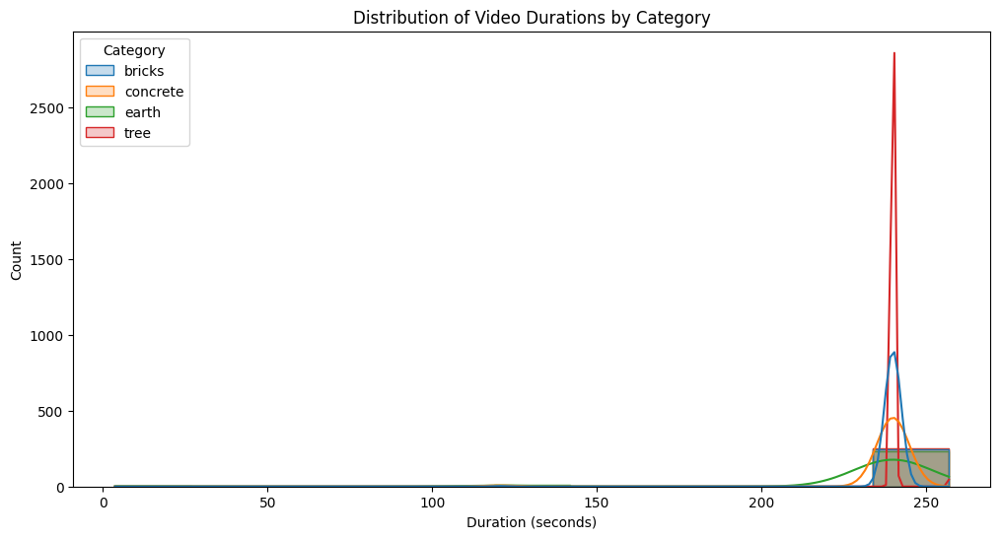

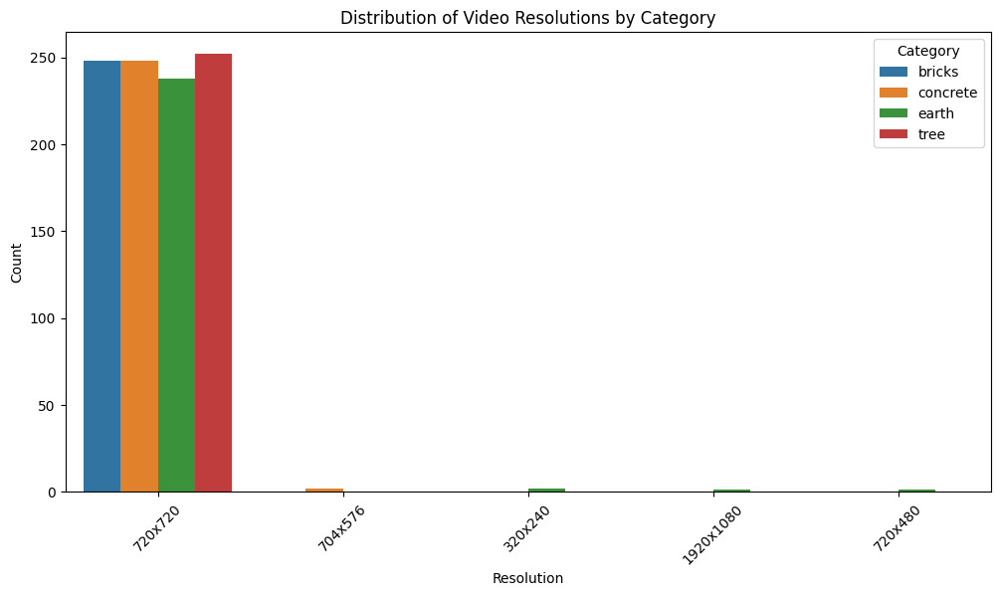

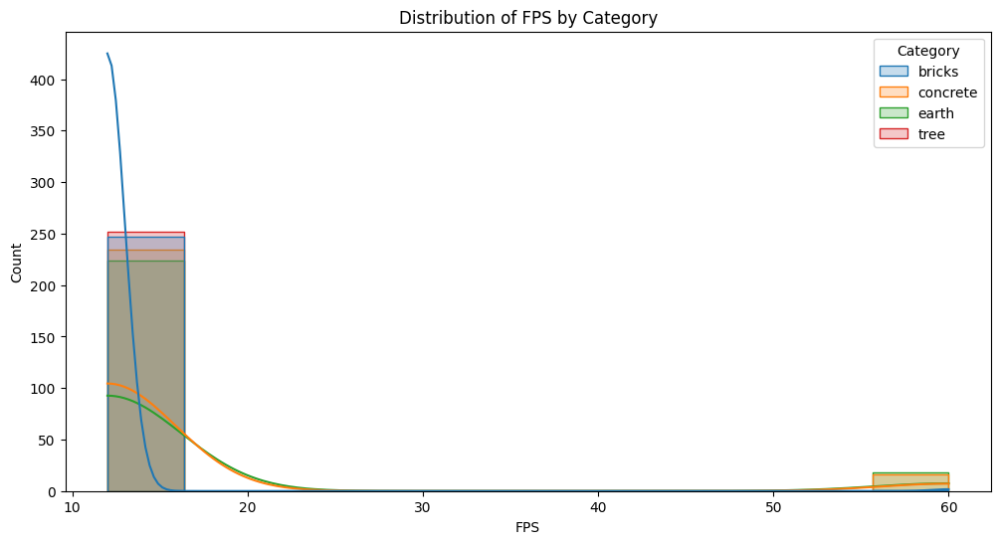

,Category,Video,Resolution,FPS,Duration
0,bricks,K387BM977_09_18_2023 17_09_02.mp4,720x720,12.0,240.0
1,bricks,K431BM977_10_12_2023 10_23_53.mp4,720x720,12.0,240.0
2,bricks,3590975.mp4,720x720,12.0,240.0
3,bricks,3656017.mp4,720x720,12.0,240.0
4,bricks,P305HP797_10_12_2023 12_34_25.mp4,720x720,12.0,240.0
...,...,...,...,...,...
987,tree,3203144.mp4,720x720,12.0,240.0
988,tree,T057OT790_05_11_2023 03_36_26.mp4,720x720,12.0,240.0
989,tree,T057OT790_05_11_2023 01_05_02.mp4,720x720,12.0,240.0
990,tree,O951TE750_07_13_2022 10_28_49.mp4,720x720,12.0,240.0


In [6]:
import cv2
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

def gather_video_info(base_path, categories):
    video_data = []

    for category in categories:
        category_path = os.path.join(base_path, category)
        videos = os.listdir(category_path)

        for video in videos:
            video_path = os.path.join(category_path, video)
            cap = cv2.VideoCapture(video_path)

            if cap.isOpened():
                width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
                height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
                fps = cap.get(cv2.CAP_PROP_FPS)
                frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
                duration = frame_count / fps if fps > 0 else 0

                video_data.append({
                    'Category': category,
                    'Video': video,
                    'Resolution': f"{width}x{height}",
                    'FPS': fps,
                    'Duration': duration
                })

            cap.release()

    return pd.DataFrame(video_data)

# Base dataset directory and categories
dataset_dir = '/kaggle/input/mos-trash/train_dataset_train/train'
categories = ['bricks', 'concrete', 'earth', 'tree']

# Gather video information
video_df = gather_video_info(dataset_dir, categories)

# Display Distributions
# Duration Distribution
plt.figure(figsize=(12, 6))
sns.histplot(data=video_df, x='Duration', hue='Category', element='step', kde=True)
plt.title("Distribution of Video Durations by Category")
plt.xlabel("Duration (seconds)")
plt.ylabel("Count")
plt.show()

# Resolution Distribution
plt.figure(figsize=(12, 6))
sns.countplot(data=video_df, x='Resolution', hue='Category')
plt.title("Distribution of Video Resolutions by Category")
plt.xlabel("Resolution")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

# FPS Distribution
plt.figure(figsize=(12, 6))
sns.histplot(data=video_df, x='FPS', hue='Category', element='step', kde=True)
plt.title("Distribution of FPS by Category")
plt.xlabel("FPS")
plt.ylabel("Count")
plt.show()

video_df

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

def find_outliers_by_frequency(df, metric):
    most_frequent = df[metric].mode()[0]
    outliers = df[df[metric] != most_frequent]
    return outliers

video_df[['Width', 'Height']] = video_df['Resolution'].str.split('x', expand=True).astype(int)

# Define metrics
metrics = ['Duration', 'FPS', 'Width', 'Height']

# Create Boxplots and Identify Outliers
for metric in metrics:
    plt.figure(figsize=(12, 6))
    sns.boxplot(data=video_df, x='Category', y=metric)
    plt.title(f"Boxplot of {metric} by Category")

    # Print Outlier Paths with Metric based on frequency
    for category in categories:
        category_data = video_df[video_df['Category'] == category]
        outliers = find_outliers_by_frequency(category_data, metric)

        # Annotate boxplot with number of outliers
        num_outliers = len(outliers)
        plt.text(categories.index(category), category_data[metric].max(), f'Outliers: {num_outliers}', 
                 horizontalalignment='center', size='small', color='black', weight='semibold')

        # Print Outlier Details
        print(f"\nOutliers in {category} for {metric} (based on frequency):")
        for _, outlier in outliers.iterrows():
            outlier_value = outlier[metric]
            outlier_path = os.path.join(dataset_dir, category, outlier['Video'])
            print(f" - {metric} Outlier (Value: {outlier_value}): {os.path.join(category, outlier['Video'])}")

    plt.xlabel("Category")
    plt.ylabel(metric)
    plt.show()
    print("\n")


In [8]:
def non_outliers_df(df, metric):
    most_frequent = df[metric].mode()[0]
    non_outliers = df[df[metric] == most_frequent]
    return non_outliers

# Define metrics
# metrics = ['Duration', 'FPS', 'Width', 'Height']
metrics = ['Duration', 'Width', 'Height']

# Start with the full dataset
filtered_df = video_df.copy()

# Sequentially filter non-outliers for each metric
for metric in metrics:
    filtered_df = non_outliers_df(filtered_df, metric)

# Now, filtered_df contains only the videos that are non-outliers for all metrics
non_outlier_videos = filtered_df

# Check if all values are the same within each metric
for metric in metrics:
    unique_values = non_outlier_videos[metric].unique()
    print(f"{metric}: Unique Values - {unique_values}")


Duration: Unique Values - [240.]
Width: Unique Values - [720]
Height: Unique Values - [720]


In [9]:
# Count original videos in each category
original_counts = video_df['Category'].value_counts()

# Count videos in each category after removing outliers
remaining_counts = non_outlier_videos['Category'].value_counts()

# Calculate percentage removed for each category
percent_removed = ((original_counts - remaining_counts) / original_counts) * 100

# Display counts and percentages
tot_percent = 0
for category in categories:
    original = original_counts.get(category, 0)
    remaining = remaining_counts.get(category, 0)
    percent = percent_removed.get(category, 0)
    print(f"Category: {category}")
    print(f"Original Count: {original}, Remaining Count: {remaining}, Percent Removed: {percent:.2f}%\n")
    tot_percent+=percent
    
print(f"\nTotal Percent Removed: {tot_percent:.2f}%\n")

Category: bricks
Original Count: 248, Remaining Count: 247, Percent Removed: 0.40%

Category: concrete
Original Count: 250, Remaining Count: 234, Percent Removed: 6.40%

Category: earth
Original Count: 242, Remaining Count: 224, Percent Removed: 7.44%

Category: tree
Original Count: 252, Remaining Count: 249, Percent Removed: 1.19%


Total Percent Removed: 15.43%



In [10]:
non_outlier_videos

,Category,Video,Resolution,FPS,Duration,Width,Height
0,bricks,K387BM977_09_18_2023 17_09_02.mp4,720x720,12.0,240.0,720,720
1,bricks,K431BM977_10_12_2023 10_23_53.mp4,720x720,12.0,240.0,720,720
2,bricks,3590975.mp4,720x720,12.0,240.0,720,720
3,bricks,3656017.mp4,720x720,12.0,240.0,720,720
4,bricks,P305HP797_10_12_2023 12_34_25.mp4,720x720,12.0,240.0,720,720
...,...,...,...,...,...,...,...
986,tree,X318XT799_04_18_2023 01_35_32.mp4,720x720,12.0,240.0,720,720
987,tree,3203144.mp4,720x720,12.0,240.0,720,720
988,tree,T057OT790_05_11_2023 03_36_26.mp4,720x720,12.0,240.0,720,720
989,tree,T057OT790_05_11_2023 01_05_02.mp4,720x720,12.0,240.0,720,720


# Cropping videos

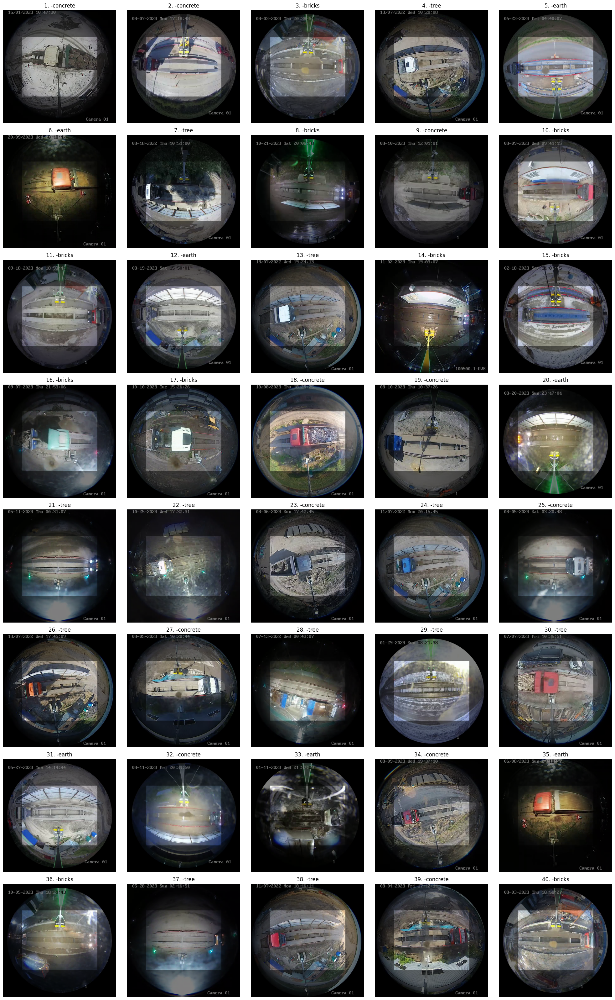

In [11]:
import matplotlib.pyplot as plt
import cv2
import numpy as np
import random
from math import ceil

def display_shadowed_videos(df, num_videos=40, cropx=120, cropy=170, cols=5, alpha=0.5):
    if len(df) < num_videos:
        print(f"Only {len(df)} videos available, displaying all.")
        num_videos = len(df)

    global random_videos
    random_videos = df.sample(n=num_videos)
    rows = num_videos // cols + (num_videos % cols > 0)

    fig, axes = plt.subplots(rows, cols, figsize=(20, 4 * rows))
    if rows == 1:
        axes = [axes]

    for idx, (_, video) in enumerate(random_videos.iterrows()):
        video_path = os.path.join(dataset_dir, video['Category'], video['Video'])
        cap = cv2.VideoCapture(video_path)

        if cap.isOpened():
            total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
            video_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
            video_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

            three_quarter_frame_index = total_frames // 2
            cap.set(cv2.CAP_PROP_POS_FRAMES, three_quarter_frame_index)
            ret, frame = cap.read()

            if ret:
                shadowed_frame = np.copy(frame)

                # Dynamic box_start and box_end based on video dimensions
                box_start = (cropx, cropy)
                box_end = (video_width - cropx, video_height - cropy)

                # Apply shadow effect with alpha parameter
                shadow_intensity = 1 - alpha
                shadowed_frame[:box_start[1], :] = (shadowed_frame[:box_start[1], :] * shadow_intensity).astype(np.uint8)
                shadowed_frame[box_end[1]:, :] = (shadowed_frame[box_end[1]:, :] * shadow_intensity).astype(np.uint8)
                shadowed_frame[box_start[1]:box_end[1], :box_start[0]] = (shadowed_frame[box_start[1]:box_end[1], :box_start[0]] * shadow_intensity).astype(np.uint8)
                shadowed_frame[box_start[1]:box_end[1], box_end[0]:] = (shadowed_frame[box_start[1]:box_end[1], box_end[0]:] * shadow_intensity).astype(np.uint8)

                shadowed_frame = cv2.cvtColor(shadowed_frame, cv2.COLOR_BGR2RGB)

                ax = axes[idx // cols][idx % cols] if rows > 1 else axes[idx]
                ax.imshow(shadowed_frame)
                ax.set_title(f"{idx+1}. -{video['Category']}")
                ax.axis('off')
            cap.release()
        else:
            print(f"Error: Could not open video {video_path}")

    plt.tight_layout()
    plt.show()

# Example usage
display_shadowed_videos(non_outlier_videos)  # Adjust alpha as needed

# Getting contours

In [16]:
import shutil

In [ ]:
import numpy as np
from scipy.stats import norm
import cv2
from matplotlib import pyplot as plt

def calculate_inversed_gaussian_mean(frames, visualize_weights=False):
    num_frames = len(frames)
    if num_frames == 0:
        return None

    # Gaussian weights centered and normalized
    x = np.arange(num_frames)
    gaussian_weights = norm.pdf(x, loc=num_frames / 2, scale=num_frames / 5)

    # Invert weights (1 - normalized weight)
    inverted_weights = 1 - gaussian_weights / gaussian_weights.max()

    # Visualize weight distribution
    if visualize_weights:
        plt.plot(x, inverted_weights, label='Inversed Gaussian Weights')
        plt.xlabel('Frame Index')
        plt.ylabel('Weight')
        plt.title('Inversed Gaussian Weight Distribution')
        plt.legend()
        plt.grid(True)
        plt.show()

    # Apply inverted weights to frames
    weighted_sum = np.zeros_like(frames[0], dtype=np.float64)
    for frame, weight in zip(frames, inverted_weights):
        weighted_sum += frame * weight

    # Calculate weighted mean frame
    total_weight = inverted_weights.sum()
    mean_frame = (weighted_sum / total_weight).astype(np.uint8)

    return mean_frame

# Example usage
# Assuming 'frames' is a list of your cropped frames
num_images = 480
frames = [np.random.randint(0, 256, (300, 400, 3), dtype=np.uint8) for _ in range(num_images)]
mean_frame = calculate_inversed_gaussian_mean(frames, visualize_weights=True)

# Display the mean frame
if mean_frame is not None:
    plt.imshow(cv2.cvtColor(mean_frame, cv2.COLOR_BGR2RGB))
    plt.title("Inversed Gaussian Weighted Mean Frame")
    plt.axis('off')
    plt.show()


# Finally

In [18]:
import cv2
import numpy as np
import os
import shutil
from math import ceil
import matplotlib.pyplot as plt


def save_cropped_contours(video_path, contour_width_threshold=140, contour_height_threshold=140, 
                          debug=False, history_length=12,
                          start_time='1:47', end_time='2:27', cropx=125, cropy=175, 
                          limit_save=35):
    
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print("Error opening video file")
        return

    # Trimming and cropping setup
    start_min, start_sec = map(int, start_time.split(':'))
    end_min, end_sec = map(int, end_time.split(':'))
    start_frame_time = (start_min * 60 + start_sec) * 1000  # Convert to milliseconds
    end_frame_time = (end_min * 60 + end_sec) * 1000
    fps = cap.get(cv2.CAP_PROP_FPS)
    cap.set(cv2.CAP_PROP_POS_MSEC, start_frame_time)
    
    # Get a mean frame across the duration of the video
    total_frames = int((end_frame_time - start_frame_time) * fps / 1000)
    cap.set(cv2.CAP_PROP_POS_MSEC, start_frame_time)
    frames = [cap.retrieve()[1][cropy:-cropy, cropx:-cropx] for _ in range(total_frames) if cap.grab()]
    mean_frame = calculate_inversed_gaussian_mean(frames)

    if debug and mean_frame is not None:
        plt.imshow(cv2.cvtColor(mean_frame, cv2.COLOR_BGR2RGB))
        plt.title("Inversed Gaussian Weighted Mean Frame")
        plt.axis('off')
        plt.show()

    cap.set(cv2.CAP_PROP_POS_MSEC, start_frame_time)

    # Setup for processing
    frames_with_contours = []
    debug_frames = []

    while True:
        ret, frame = cap.read()
        current_time = cap.get(cv2.CAP_PROP_POS_MSEC)
        if not ret or current_time > end_frame_time:
            break

        if current_time >= start_frame_time:
            cropped_frame = frame[cropy:-cropy, cropx:-cropx]

            # Compare with mean frame
            diff_frame = cv2.absdiff(mean_frame, cropped_frame)
            gray = cv2.cvtColor(diff_frame, cv2.COLOR_BGR2GRAY)
            blurred = cv2.GaussianBlur(gray, (5, 5), 0)
            ret, thresh = cv2.threshold(blurred, 20, 255, cv2.THRESH_BINARY)
            dilated = cv2.dilate(thresh, np.ones((3, 3), np.uint8), iterations=3)
            contours, _ = cv2.findContours(dilated, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

            largest_contour = None
            max_area = 0
            for contour in contours:
                x, y, w, h = cv2.boundingRect(contour)
                area = cv2.contourArea(contour)
                if w >= contour_width_threshold and h >= contour_height_threshold and area > max_area:
                    largest_contour = contour
                    max_area = area

            # Debug visualization
            debug_frame = cropped_frame.copy()
            if largest_contour is not None:
                x, y, w, h = cv2.boundingRect(largest_contour)
                cv2.rectangle(debug_frame, (x, y), (x + w, y + h), (0, 255, 0), 2)
                contour_cropped = cropped_frame[y:y+h, x:x+w]
                frames_with_contours.append(contour_cropped)

            debug_frames.append(debug_frame)

    parts = video_path.split('/')
    category = parts[-2] if len(parts) > 1 else 'unknown_category'
    video_name = os.path.basename(video_path).split('.')[0]
    output_dir = f'/kaggle/working/frames/{category}/{video_name}'
    os.makedirs(output_dir, exist_ok=True)
    
    # Calculate indices for slicing
    start_index = int(len(frames_with_contours) * 0.2)
    end_index = int(len(frames_with_contours) * 0.9)

    # Select every third frame from the specified range
    selected_frames = frames_with_contours[start_index:end_index:3]

    # Calculate middle section for limit_save frames
    middle_section_start = max(0, len(selected_frames) // 2 - limit_save // 2)
    middle_section_end = min(len(selected_frames), middle_section_start + limit_save)

    # Save the frames
    for i, cropped_contour in enumerate(selected_frames[middle_section_start:middle_section_end]):
        cv2.imwrite(os.path.join(output_dir, f"{i + 1}.jpg"), cropped_contour)


    if debug:
        cols = 16
        rows = ceil(len(debug_frames) / cols)
        fig, axes = plt.subplots(rows, cols, figsize=(20, rows))
        axes = axes.flatten()
        for idx, frame in enumerate(debug_frames):
            axes[idx].imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            axes[idx].axis('off')
        for idx in range(len(debug_frames), len(axes)):
            axes[idx].axis('off')
        plt.tight_layout()
        plt.show()

    cap.release()
    print(f"Cropped contours saved in {output_dir}.")

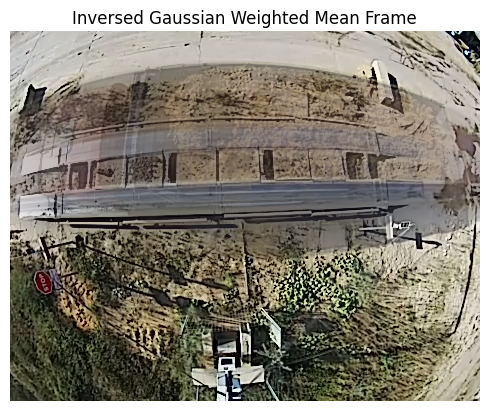

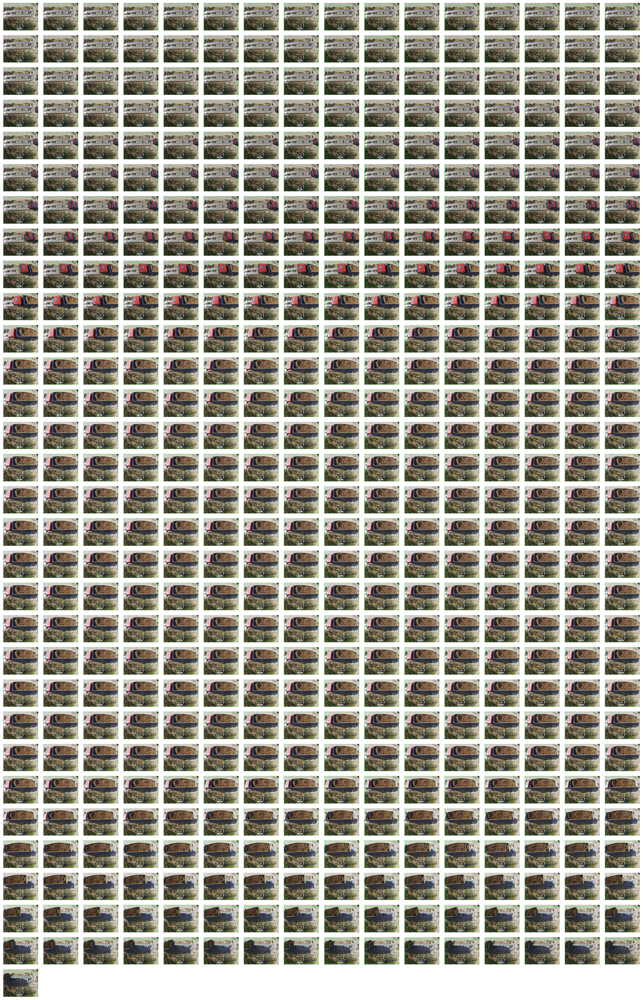

Cropped contours saved in /kaggle/working/frames/earth/H883AP977_09_20_2023 14_54_57.
35


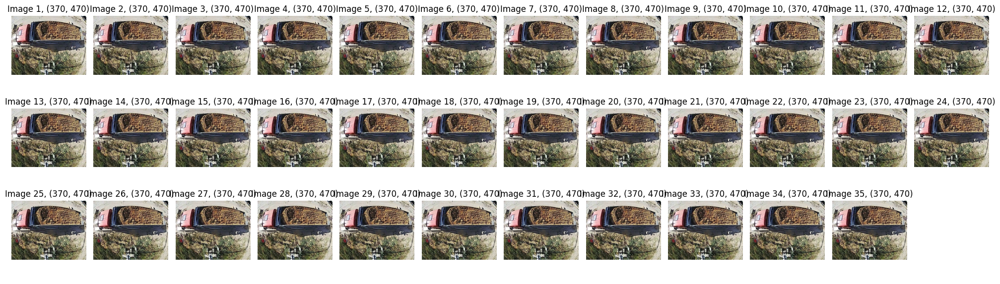

In [19]:
def visualize_cropped_images(output_dir, cols=12):
    # List all image files in the output directory
    images = [img for img in os.listdir(output_dir) if img.endswith('.jpg')]
    images= sorted(images, key=lambda x: int(x.split('.')[0]))
    print(len(images))
    if not images:
        print("No images found in the directory.")
        return

    # Determine the number of rows needed for the subplot
    num_images = len(images)
    rows = ceil(num_images / cols)
    fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 2))
    axes = axes.flatten()

    for idx, img_file in enumerate(images):
        img_path = os.path.join(output_dir, img_file)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB
        axes[idx].imshow(img)
        axes[idx].set_title(f"Image {idx+1}, {(img.shape[0], img.shape[1])}")
        axes[idx].axis('off')
    # Hide any unused subplots
    for idx in range(num_images, len(axes)):
        axes[idx].axis('off')
    plt.tight_layout()
    plt.show()


def save_and_visualise(video_path, debug=False):
    parts = video_path.split('/')
    category = parts[-2] if len(parts) > 1 else 'unknown_category'
    video_name = os.path.basename(video_path).split('.')[0]
    output_dir = f'/kaggle/working/frames/{category}/{video_name}'
    
    save_cropped_contours(video_path, debug=debug)
    visualize_cropped_images(output_dir)
    
# video_path = '/kaggle/input/mos-trash/train_dataset_train/train/tree/H400XK799_02_01_2023 04_40_50.mp4'
video_path = '/kaggle/input/mos-trash/train_dataset_train/train/earth/H883AP977_09_20_2023 14_54_57.mp4'
save_and_visualise(video_path, debug=True)

Processing /kaggle/input/mos-trash/train_dataset_train/train/earth/A832OX790_09_19_2023 20_13_22.mp4
Cropped contours saved in /kaggle/working/frames/earth/A832OX790_09_19_2023 20_13_22.
15


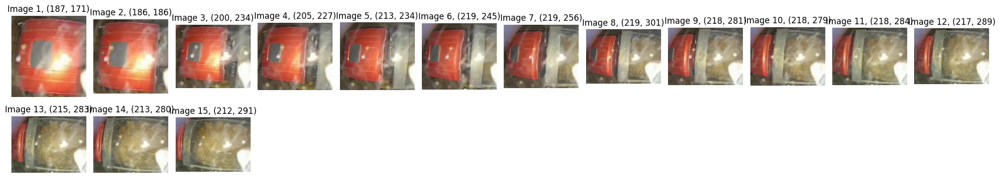

Processing /kaggle/input/mos-trash/train_dataset_train/train/earth/M233KA716_01_26_2023 02_52_04.mp4
Cropped contours saved in /kaggle/working/frames/earth/M233KA716_01_26_2023 02_52_04.
35


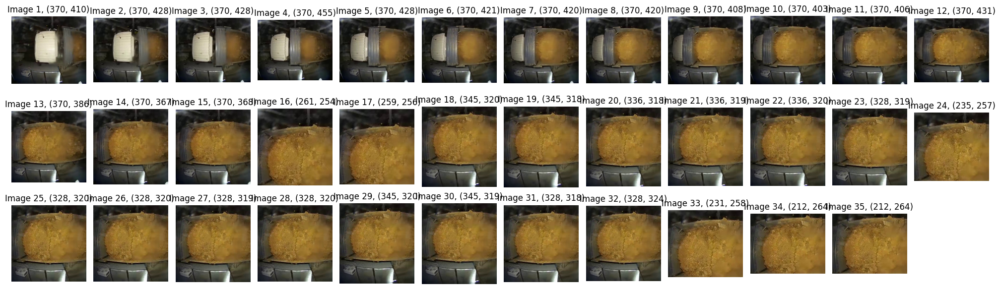

Processing /kaggle/input/mos-trash/train_dataset_train/train/earth/C260MT777_04_23_2023 17_06_04.mp4
Cropped contours saved in /kaggle/working/frames/earth/C260MT777_04_23_2023 17_06_04.
35


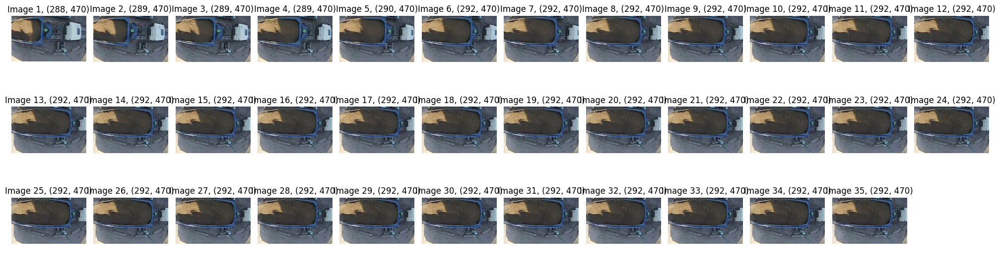

Processing /kaggle/input/mos-trash/train_dataset_train/train/earth/3486520.mp4
Cropped contours saved in /kaggle/working/frames/earth/3486520.
35


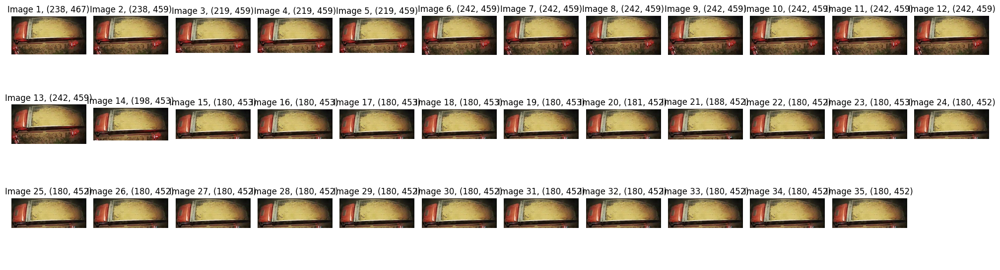

Processing /kaggle/input/mos-trash/train_dataset_train/train/bricks/K387BM977_08_25_2023 11_19_18.mp4
Cropped contours saved in /kaggle/working/frames/bricks/K387BM977_08_25_2023 11_19_18.
35


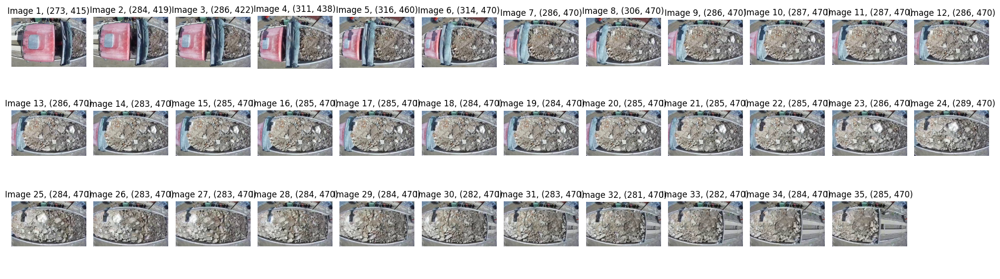

Processing /kaggle/input/mos-trash/train_dataset_train/train/bricks/P305HP797_10_23_2023 11_26_56.mp4
Cropped contours saved in /kaggle/working/frames/bricks/P305HP797_10_23_2023 11_26_56.
35


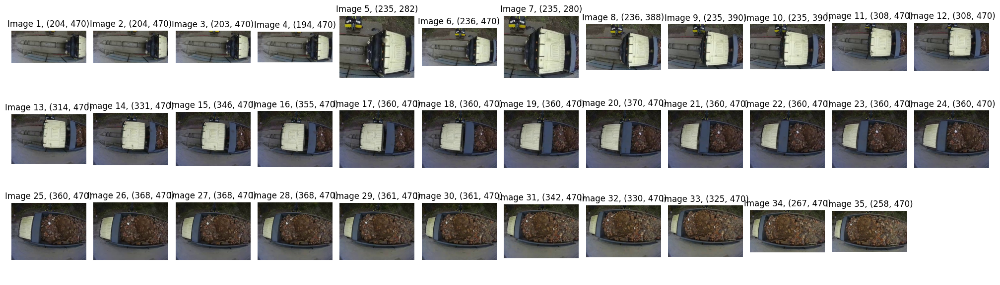

Processing /kaggle/input/mos-trash/train_dataset_train/train/bricks/P657HP797_10_13_2023 18_11_10.mp4
Cropped contours saved in /kaggle/working/frames/bricks/P657HP797_10_13_2023 18_11_10.
35


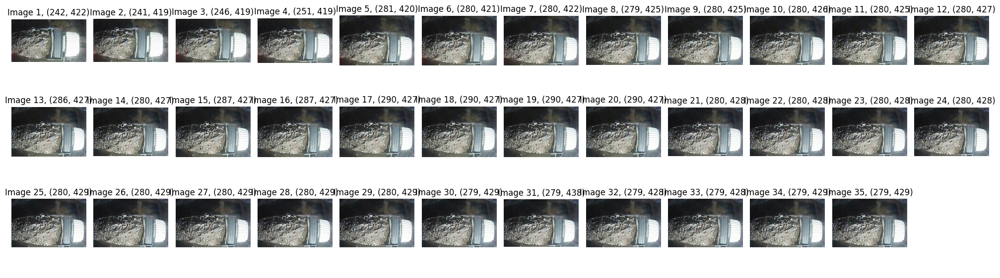

Processing /kaggle/input/mos-trash/train_dataset_train/train/bricks/K260BM977_08_03_2023 20_39_19.mp4
Cropped contours saved in /kaggle/working/frames/bricks/K260BM977_08_03_2023 20_39_19.
35


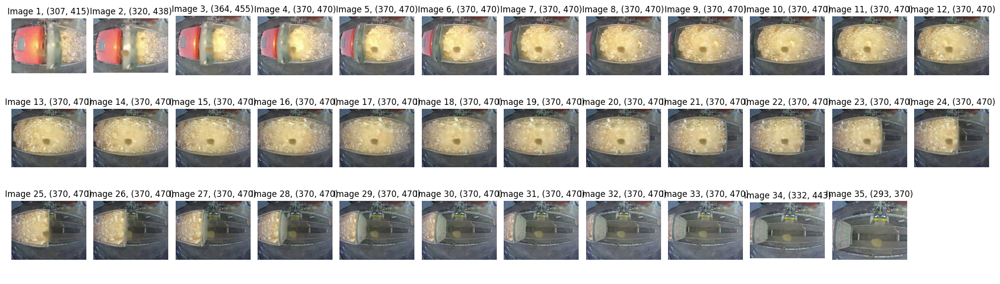

Processing /kaggle/input/mos-trash/train_dataset_train/train/tree/E603KT790_05_28_2023 00_00_00.mp4
Cropped contours saved in /kaggle/working/frames/tree/E603KT790_05_28_2023 00_00_00.
35


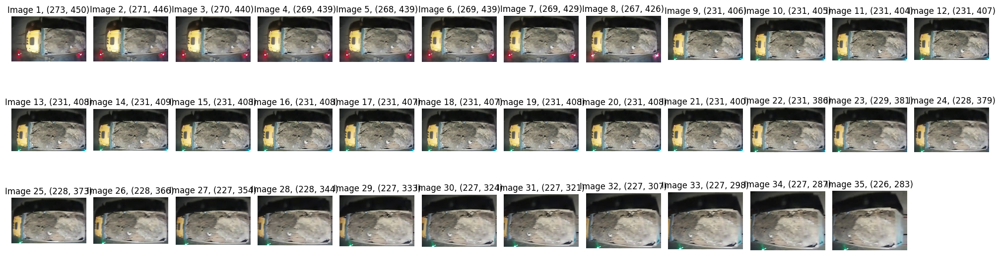

Processing /kaggle/input/mos-trash/train_dataset_train/train/tree/P293BH790_05_27_2023 05_40_29.mp4
Cropped contours saved in /kaggle/working/frames/tree/P293BH790_05_27_2023 05_40_29.
35


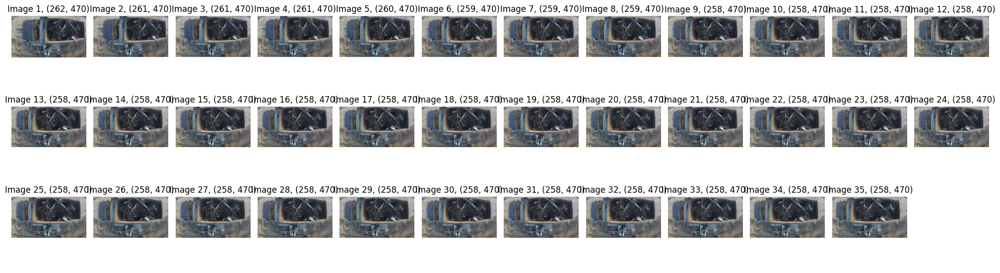

Processing /kaggle/input/mos-trash/train_dataset_train/train/tree/O951TE750_07_12_2022 15_54_57.mp4
Cropped contours saved in /kaggle/working/frames/tree/O951TE750_07_12_2022 15_54_57.
35


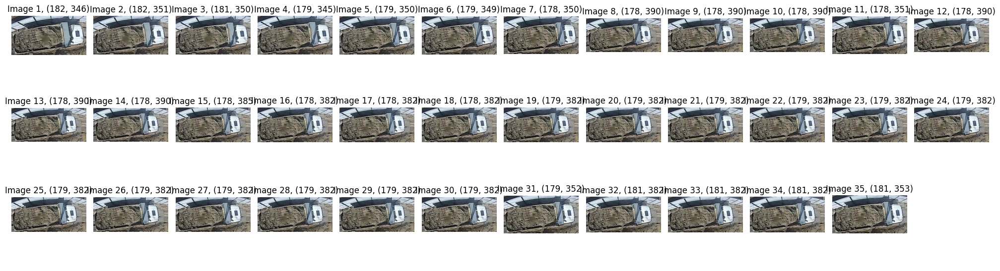

Processing /kaggle/input/mos-trash/train_dataset_train/train/tree/K609YM799_02_08_2023 12_54_21.mp4
Cropped contours saved in /kaggle/working/frames/tree/K609YM799_02_08_2023 12_54_21.
35


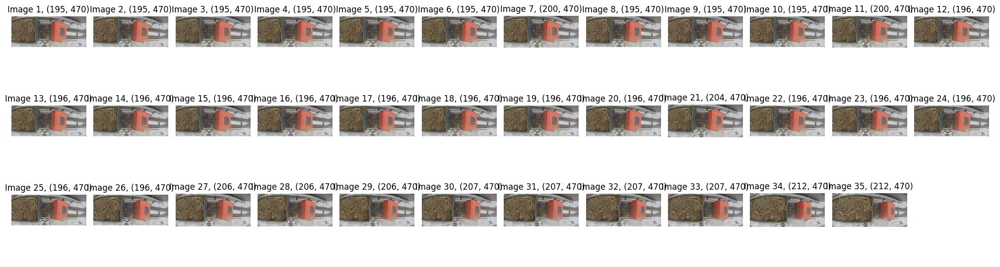

Processing /kaggle/input/mos-trash/train_dataset_train/train/concrete/P785KX797_08_08_2023 11_57_58.mp4
Cropped contours saved in /kaggle/working/frames/concrete/P785KX797_08_08_2023 11_57_58.
35


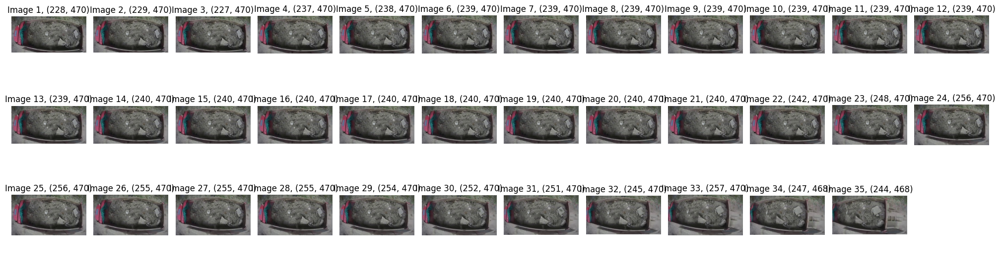

Processing /kaggle/input/mos-trash/train_dataset_train/train/concrete/C742PC799_08_02_2023 12_23_14.mp4
Cropped contours saved in /kaggle/working/frames/concrete/C742PC799_08_02_2023 12_23_14.
35


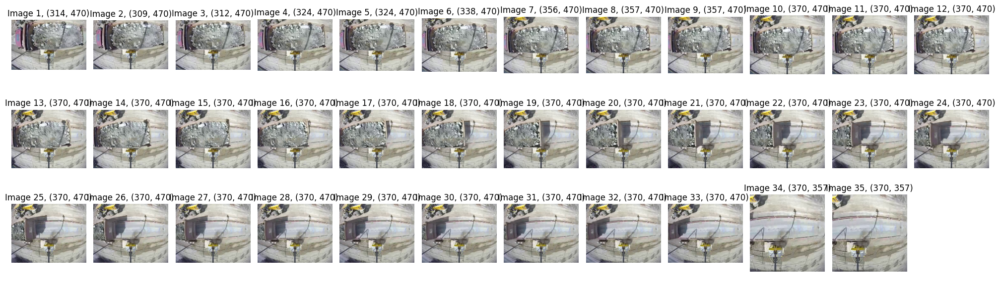

Processing /kaggle/input/mos-trash/train_dataset_train/train/concrete/Y540YM71_08_01_2023 17_55_15.mp4
Cropped contours saved in /kaggle/working/frames/concrete/Y540YM71_08_01_2023 17_55_15.
35


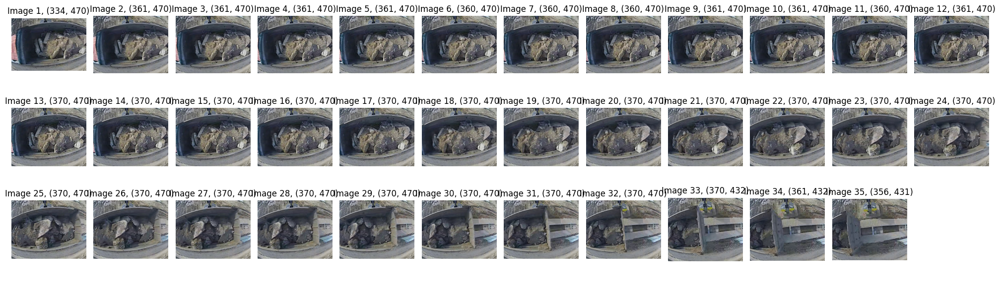

Processing /kaggle/input/mos-trash/train_dataset_train/train/concrete/M575YX799_08_11_2023 03_51_22.mp4
Cropped contours saved in /kaggle/working/frames/concrete/M575YX799_08_11_2023 03_51_22.
35


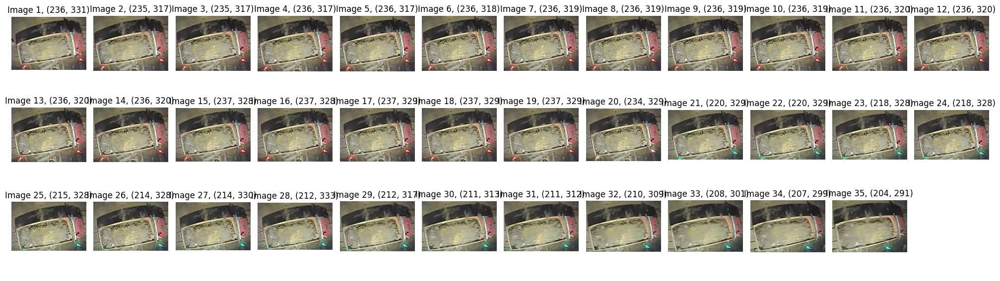

In [20]:
def process_random_videos(base_path, num_videos=4):
    categories = [d for d in os.listdir(base_path) if os.path.isdir(os.path.join(base_path, d))]
    
    for category in categories:
        category_path = os.path.join(base_path, category)
        videos = [f for f in os.listdir(category_path) if f.endswith('.mp4')]
        selected_videos = random.sample(videos, min(len(videos), num_videos))

        for video in selected_videos:
            video_path = os.path.join(category_path, video)
            print(f"Processing {video_path}")
            save_and_visualise(video_path, debug=False)

base_path = '/kaggle/input/mos-trash/train_dataset_train/train/'
process_random_videos(base_path)

# Getting images

In [21]:
directory = '/kaggle/working'

# Check if the directory exists
if os.path.exists(directory):
    # Remove all contents of the directory
    for filename in os.listdir(directory):
        file_path = os.path.join(directory, filename)
        try:
            if os.path.isfile(file_path) or os.path.islink(file_path):
                os.unlink(file_path)
            elif os.path.isdir(file_path):
                shutil.rmtree(file_path)
        except Exception as e:
            print(f'Failed to delete {file_path}. Reason: {e}')
    print("Kaggle working directory emptied.")
else:
    print("Directory does not exist.")

Kaggle working directory emptied.


In [ ]:
import os
from tqdm.notebook import tqdm

base_dir = '/kaggle/input/mos-trash/train_dataset_train/train/'

categories = [d for d in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, d))]
for category in tqdm(categories, desc='Categories'):
    category_path = os.path.join(base_dir, category)
    video_files = [f for f in os.listdir(category_path) if f.endswith('.mp4')]
    for video_file in tqdm(video_files, desc=f'Processing videos in {category}'):
        video_path = os.path.join(category_path, video_file)
        save_cropped_contours(video_path)
        